What this notebook does:

Computes coffee shop averages for topic-specific sentiment for the 5 topic LDA importance vectors.For each review, the compound Vader sentiment of each sentence was assigned to a topic based on LDA topic importance (see './LDA_5topic_SentimentAssignment/EngineeringFeatures_basedon_5LDAnountopics.ipynb'). The sentiments associated with each topic in the review were averaged separately from one another.

Visualizes the distribution of the shop-specific averages of topic-sentiment. 

Visualizes the geographic distribution of the 5 topic sentiments for different shops

In [ ]:
#Step one directory up to access the yelp scraping function in the helper_functions module
import os
print(os.getcwd())
os.chdir('../')
os.getcwd()

In [1]:
#General packages
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt

In [2]:
#For plotting on maps
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import descartes

#For creating interactive maps
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

#Let's look at the distribution of the coffee shops on a map
# import libraries
import geopandas as gpd
from shapely.geometry import Point, Polygon
import matplotlib.pyplot as plt

import branca

In [3]:

reviews = pd.read_csv('./ProcessedData/reviews_withlda5topicfeatures.csv')
print(reviews.columns)
shops = pd.read_csv('./ProcessedData/coffeeshops_withcfcutoff.csv')

#add length of review as a feature
reviews['len'] = [len(wordlist) for wordlist in reviews.mreviewtxt.str.split().to_list()]

topiclabels = ['Coffee','Ambience','Lines','Food','Sweets']

Index(['id', 'name', 'alias', 'is_closed', 'review_count', 'price', 'rating',
       'transactions', 'latitude', 'longitude', 'geometry', 'index_right',
       'boro_code', 'boro_name', 'county_fip', 'ntacode', 'ntaname',
       'shape_area', 'shape_leng', 'catlist', 'numcoffeemen', 'numreviews',
       'fraccof', 'name_top5count', 'reviewidx', 'shopidx', 'date',
       'revrating', 'reviewtxt', 'mreviewtxt', 'review_lem_noun',
       'review_lem_nounverb', 'review_lem_nounadj', 'reviewtxt_periodonly',
       'review_lem_withperiod', 'vadersentiment_sentavg', 't0s', 't1s', 't2s',
       't3s', 't4s', 't0', 't1', 't2', 't3', 't4', 'vadersentiment'],
      dtype='object')


Now computing the mean (within each coffeeshop), of topic importances and sentiments

In [14]:
merged = reviews
avgtopicbyalias = merged.groupby('alias')[['t0s','t1s','t2s','t3s','t4s','len','t0',
                                          't1','t2','t3','t4']].mean()
avgtopicbyalias.reset_index()
avgtopicbyalias = avgtopicbyalias.merge(shops,how='inner',on='alias')

avgtopicbyalias.columns

Index(['alias', 't0s', 't1s', 't2s', 't3s', 't4s', 'len', 't0', 't1', 't2',
       't3', 't4', 'id', 'name', 'is_closed', 'review_count', 'price',
       'rating', 'transactions', 'latitude', 'longitude', 'geometry',
       'index_right', 'boro_code', 'boro_name', 'county_fip', 'ntacode',
       'ntaname', 'shape_area', 'shape_leng', 'catlist', 'numcoffeemen',
       'numreviews', 'fraccof', 'name_top5count'],
      dtype='object')

### Visualizing Topic Sentiment vs Topic Importance for Different Shops

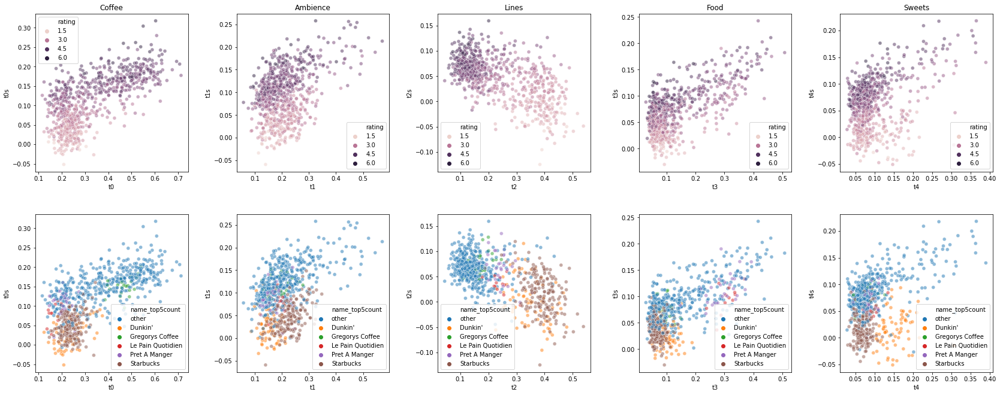

In [18]:
#Visualizing the average sentiment scores for each topic for different restaurants
fig,ax = plt.subplots(2,5,figsize=(24,10))
fig.tight_layout(pad=5)
for i in range(5):
    sns.scatterplot(x='t' + str(i),y='t' + str(i) +'s',hue = 'rating', data= avgtopicbyalias, alpha=0.5,ax=ax[0,i])
    ax[0,i].set_title(topiclabels[i])
    
for i in range(5):
    sns.scatterplot(x='t' + str(i),y='t' + str(i) +'s',hue = 'name_top5count', data= avgtopicbyalias, alpha=0.5,ax=ax[1,i])



### Plotting coffee shop sentiments on a map

In [19]:
avgtopicbyalias.head(1)
avgtopicbyalias.columns


Index(['alias', 't0s', 't1s', 't2s', 't3s', 't4s', 'len', 't0', 't1', 't2',
       't3', 't4', 'id', 'name', 'is_closed', 'review_count', 'price',
       'rating', 'transactions', 'latitude', 'longitude', 'geometry',
       'index_right', 'boro_code', 'boro_name', 'county_fip', 'ntacode',
       'ntaname', 'shape_area', 'shape_leng', 'catlist', 'numcoffeemen',
       'numreviews', 'fraccof', 'name_top5count'],
      dtype='object')

In [28]:
#For each of the 5 topics, plot the topic sentiments on a map
m_1 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_2 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_3 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_4 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_5 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)

#add shops to the map, color coded by price
maps = [m_1,m_2,m_3,m_4,m_5]

colorscale = branca.colormap.linear.YlOrRd_09.scale(0, 0.5)    

for i in range(0,len(avgtopicbyalias)):
    for j,m in enumerate(maps):
        Circle(
            location=[avgtopicbyalias.iloc[i]['latitude'],avgtopicbyalias.iloc[i]['longitude']],
            radius = 20, 
            color = colorscale(avgtopicbyalias.iloc[i]['t' + str(j) + 's'])).add_to(m)

        
for j,m in enumerate(maps):
    colormap = branca.colormap.linear.YlOrRd_09.scale(-0.05, 0.05)
    colormap.caption = 'Average sentiment for ' + topiclabels[j]
    colormap.add_to(m)
    

#display the maps. Coffee topic
maps[0]

In [29]:
maps[1]

In [30]:
maps[2]

In [31]:
maps[3]

In [32]:
maps[4]

Observations of the geographic distribution of average topic components for coffee shops.

1. For most coffee shops in our data set, the amount of food discussion in a reviews is pretty low. This is also the case for the coffee/tea topic.

2. Average coffee fraction is higher for most coffee shops in the data set. This topic has the highest average review fraction for most coffee shops

3. The tables/seating topic t0, and line/time topic t2 have higher review components than the food (t1) and tea/chocolate (t4) topics.  The line/time topic appears to have a hotspot of high values at the southern tip of manhattan and closer to midtown. The tables/seating topic appears to have the opposite pattern.

### Computing and plotting averages of topic sentiment by neighborhood (NTA)

In [34]:
avgtopicbyalias = merged.groupby('alias')[['t0s','t1s','t2s','t3s','t4s']].mean()
avgtopicbyalias.reset_index()
avgtopicbyalias = pd.merge(avgtopicbyalias,shops,how='inner',on = ['alias'])

In [35]:
avgtopicbynta = avgtopicbyalias.groupby('ntacode')[['t0s','t1s','t2s','t3s','t4s']].mean()
numshopsbynta = avgtopicbyalias.groupby('ntacode')['alias'].count()
avgtopicbynta['count'] = numshopsbynta
avgtopicbynta.reset_index(inplace=True)
avgtopicbynta = avgtopicbynta[avgtopicbynta['count'] >10]

In [36]:
#Creating Chloropeth maps to show average lda topic score across coffee shops by nta region

districts_full = gpd.read_file('./NeighborhoodTabulationAreas/geo_export_635227ce-99b9-4575-b120-dba900c98200.shp')
districts = districts_full[["ntacode", "geometry"]].set_index("ntacode")
districts.head()

# Number of crimes in each police district
avgtopicbynta = avgtopicbynta.set_index("ntacode")
print(avgtopicbynta)



              t0s       t1s       t2s       t3s       t4s  count
ntacode                                                         
MN09     0.137365  0.117628  0.052629  0.092330  0.080002     13
MN12     0.102830  0.093285  0.033801  0.073599  0.064484     24
MN13     0.113694  0.093813  0.048891  0.061873  0.064386     64
MN14     0.101854  0.079958  0.026848  0.062885  0.058312     17
MN15     0.100313  0.084277  0.038906  0.063051  0.058181     29
MN17     0.099341  0.080115  0.044176  0.066238  0.055561    144
MN19     0.109729  0.081857  0.047951  0.069731  0.064427     54
MN20     0.095943  0.084328  0.044637  0.065606  0.046705     30
MN21     0.082533  0.065623  0.037031  0.054029  0.032820     12
MN22     0.132532  0.107525  0.051008  0.085350  0.070919     30
MN23     0.127271  0.115609  0.060587  0.084315  0.068981     67
MN24     0.123404  0.108005  0.050101  0.068671  0.072283     76
MN25     0.109072  0.072072  0.042494  0.060813  0.053922     51
MN27     0.139489  0.1280

In [37]:
m_1 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_2 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_3 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_4 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_5 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_6 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)

maps = [m_1,m_2,m_3,m_4,m_5,m_6]

for i in range(5):
    Choropleth(geo_data=districts.__geo_interface__, 
           data=avgtopicbynta['t' + str(i) + 's'], 
           key_on="feature.id", 
           fill_color='YlGnBu', 
           legend_name='Average Sentiment Score For ' + topiclabels[i]
          ).add_to(maps[i])
    
Choropleth(geo_data=districts.__geo_interface__, 
           data=avgtopicbynta['count'], 
           key_on="feature.id", 
           fill_color='YlGnBu', 
           legend_name='Number of coffee shops in nta district'
          ).add_to(maps[5])

# Display the maps
maps[0]

In [38]:
maps[1]

In [39]:
maps[2]

In [40]:
maps[3]

In [41]:
maps[4]

In [42]:
maps[5]

Some similar things show up with the lines/time topic (t2) and the tables seating topic (t0).  In busy places, there will probably be more mentions of lines, while in less  busy places there will be fewer of these.